In [39]:
import os
from glob import glob
from pathlib import Path

import matplotlib.pyplot as plt
import pytorch_lightning as pl
import torch
from PIL import Image
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.transforms.functional import center_crop
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np

In [2]:
path = "./facades/train/"


class FacadesDataset(Dataset):
    def __init__(self, path, target_size=None):
        self.filenames = glob(str(Path(path) / "*"))
        self.target_size = target_size

    def __len__(self):
        return len(self.filenames)

    def __getitem__(self, idx):
        filename = self.filenames[idx]
        image = Image.open(filename)
        image = transforms.functional.to_tensor(image)
        image_width = image.shape[2]

        real = image[:, :, : image_width // 2]
        condition = image[:, :, image_width // 2 :]

        target_size = self.target_size
        if target_size:
            condition = nn.functional.interpolate(condition, size=target_size)
            real = nn.functional.interpolate(real, size=target_size)

        return real, condition

In [6]:
class DownSampleConv(nn.Module):

    def __init__(self, in_channels, out_channels, kernel=4, strides=2, padding=1, activation=True, batchnorm=True):
        super().__init__()
        self.activation = activation
        self.batchnorm = batchnorm

        self.conv = nn.Conv2d(in_channels, out_channels, kernel, strides, padding)

        if batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if activation:
            self.act = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.conv(x)
        if self.batchnorm:
            x = self.bn(x)
        if self.activation:
            x = self.act(x)
        return x

In [7]:
class UpSampleConv(nn.Module):

    def __init__(
        self,
        in_channels,
        out_channels,
        kernel=4,
        strides=2,
        padding=1,
        activation=True,
        batchnorm=True,
        dropout=False
    ):
        super().__init__()
        self.activation = activation
        self.batchnorm = batchnorm
        self.dropout = dropout

        self.deconv = nn.ConvTranspose2d(in_channels, out_channels, kernel, strides, padding)

        if batchnorm:
            self.bn = nn.BatchNorm2d(out_channels)

        if activation:
            self.act = nn.ReLU(True)

        if dropout:
            self.drop = nn.Dropout2d(0.5)

    def forward(self, x):
        x = self.deconv(x)
        if self.batchnorm:
            x = self.bn(x)

        if self.dropout:
            x = self.drop(x)
        return x

In [8]:
class Generator(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()

        # encoder/donwsample convs
        self.encoders = [
            DownSampleConv(in_channels, 64, batchnorm=False),  # bs x 64 x 128 x 128
            DownSampleConv(64, 128),  # bs x 128 x 64 x 64
            DownSampleConv(128, 256),  # bs x 256 x 32 x 32
            DownSampleConv(256, 512),  # bs x 512 x 16 x 16
            DownSampleConv(512, 512),  # bs x 512 x 8 x 8
            DownSampleConv(512, 512),  # bs x 512 x 4 x 4
            DownSampleConv(512, 512),  # bs x 512 x 2 x 2
            DownSampleConv(512, 512, batchnorm=False),  # bs x 512 x 1 x 1
        ]

        # decoder/upsample convs
        self.decoders = [
            UpSampleConv(512, 512, dropout=True),  # bs x 512 x 2 x 2
            UpSampleConv(1024, 512, dropout=True),  # bs x 512 x 4 x 4
            UpSampleConv(1024, 512, dropout=True),  # bs x 512 x 8 x 8
            UpSampleConv(1024, 512),  # bs x 512 x 16 x 16
            UpSampleConv(1024, 256),  # bs x 256 x 32 x 32
            UpSampleConv(512, 128),  # bs x 128 x 64 x 64
            UpSampleConv(256, 64),  # bs x 64 x 128 x 128
        ]
        self.decoder_channels = [512, 512, 512, 512, 256, 128, 64]
        self.final_conv = nn.ConvTranspose2d(64, out_channels, kernel_size=4, stride=2, padding=1)
        self.tanh = nn.Tanh()

        self.encoders = nn.ModuleList(self.encoders)
        self.decoders = nn.ModuleList(self.decoders)

    def forward(self, x):
        skips_cons = []
        for encoder in self.encoders:
            x = encoder(x)

            skips_cons.append(x)

        skips_cons = list(reversed(skips_cons[:-1]))
        decoders = self.decoders[:-1]

        for decoder, skip in zip(decoders, skips_cons):
            x = decoder(x)
            # print(x.shape, skip.shape)
            x = torch.cat((x, skip), axis=1)

        x = self.decoders[-1](x)
        # print(x.shape)
        x = self.final_conv(x)
        return self.tanh(x)

In [9]:
class PatchGAN(nn.Module):

    def __init__(self, input_channels):
        super().__init__()
        self.d1 = DownSampleConv(input_channels, 64, batchnorm=False)
        self.d2 = DownSampleConv(64, 128)
        self.d3 = DownSampleConv(128, 256)
        self.d4 = DownSampleConv(256, 512)
        self.final = nn.Conv2d(512, 1, kernel_size=1)

    def forward(self, x, y):
        x = torch.cat([x, y], axis=1)
        x0 = self.d1(x)
        x1 = self.d2(x0)
        x2 = self.d3(x1)
        x3 = self.d4(x2)
        xn = self.final(x3)
        return xn

In [10]:
def _weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
        
def display_progress(cond, fake, real, figsize=(10,5)):
    cond = cond.detach().cpu().permute(1, 2, 0)
    fake = fake.detach().cpu().permute(1, 2, 0)
    real = real.detach().cpu().permute(1, 2, 0)
    
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    ax[0].imshow(cond)
    ax[2].imshow(fake)
    ax[1].imshow(real)
    plt.show()

In [11]:
class Pix2Pix(pl.LightningModule):

    def __init__(self, in_channels, out_channels, learning_rate=0.0002, lambda_recon=200, display_step=25):

        super().__init__()
        self.save_hyperparameters()
        
        self.display_step = display_step
        self.gen = Generator(in_channels, out_channels)
        self.patch_gan = PatchGAN(in_channels + out_channels)

        # intializing weights
        self.gen = self.gen.apply(_weights_init)
        self.patch_gan = self.patch_gan.apply(_weights_init)

        self.adversarial_criterion = nn.BCEWithLogitsLoss()
        self.recon_criterion = nn.L1Loss()

    def _gen_step(self, real_images, conditioned_images):
        # Pix2Pix has adversarial and a reconstruction loss
        # First calculate the adversarial loss
        fake_images = self.gen(conditioned_images)
        disc_logits = self.patch_gan(fake_images, conditioned_images)
        adversarial_loss = self.adversarial_criterion(disc_logits, torch.ones_like(disc_logits))

        # calculate reconstruction loss
        recon_loss = self.recon_criterion(fake_images, real_images)
        lambda_recon = self.hparams.lambda_recon

        return adversarial_loss + lambda_recon * recon_loss

    def _disc_step(self, real_images, conditioned_images):
        fake_images = self.gen(conditioned_images).detach()
        fake_logits = self.patch_gan(fake_images, conditioned_images)

        real_logits = self.patch_gan(real_images, conditioned_images)

        fake_loss = self.adversarial_criterion(fake_logits, torch.zeros_like(fake_logits))
        real_loss = self.adversarial_criterion(real_logits, torch.ones_like(real_logits))
        return (real_loss + fake_loss) / 2

    def configure_optimizers(self):
        lr = self.hparams.learning_rate
        gen_opt = torch.optim.Adam(self.gen.parameters(), lr=lr)
        disc_opt = torch.optim.Adam(self.patch_gan.parameters(), lr=lr)
        return disc_opt, gen_opt

    def training_step(self, batch, batch_idx, optimizer_idx):
        real, condition = batch

        loss = None
        if optimizer_idx == 0:
            loss = self._disc_step(real, condition)
            self.log('PatchGAN Loss', loss)
        elif optimizer_idx == 1:
            loss = self._gen_step(real, condition)
            self.log('Generator Loss', loss)
        
        if self.current_epoch%self.display_step==0 and batch_idx==0 and optimizer_idx==1:
            fake = self.gen(condition).detach()
            display_progress(condition[0], fake[0], real[0])
        return loss

In [12]:
adv_criterion = nn.BCEWithLogitsLoss() 
recon_criterion = nn.L1Loss() 
lambda_recon = 200

n_epochs = 20

display_step = 100
batch_size = 4
lr = 0.0002
target_size = 256
device = 'cuda'

/home/svetlana/.conda/envs/razor_torch/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:446: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  rank_zero_deprecation(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]

  | Name                  | Type              | Params
------------------------------------------------------------
0 | gen                   | Generator         | 54.4 M
1 | patch_gan             | PatchGAN          | 2.8 M 
2 | adversarial_criterion | BCEWithLogitsLoss | 0     
3 | recon_criterion       | L1Loss            | 0     
------------------------------------------------------------
57.2 M    Trainable params
0         Non-trainable params
57.2 M    Total params

Training: 0it [00:00, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


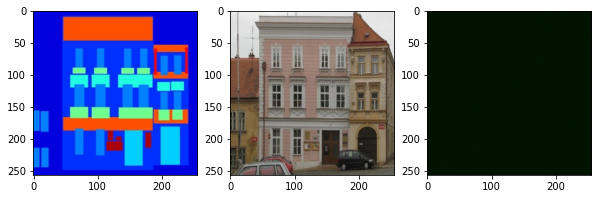

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


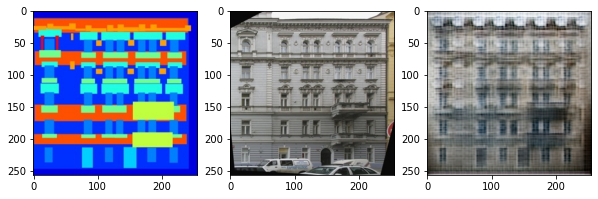

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


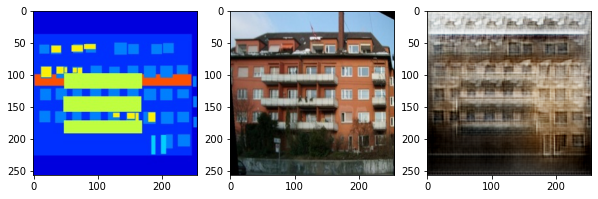

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


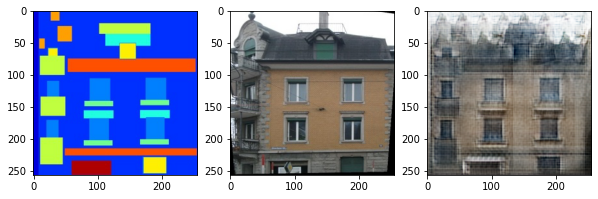

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


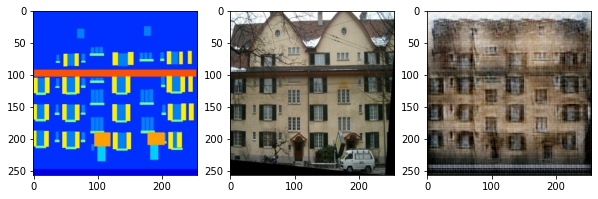

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


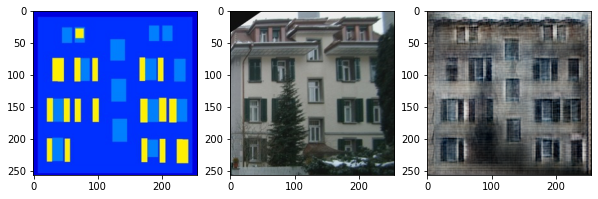

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


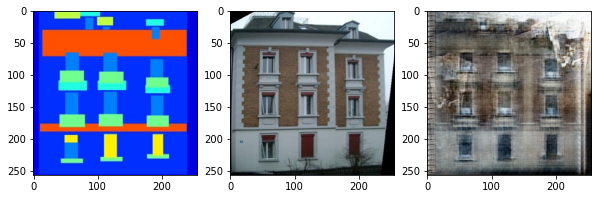

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


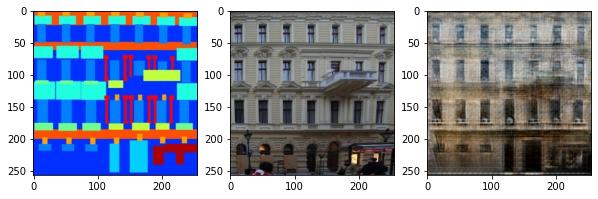

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


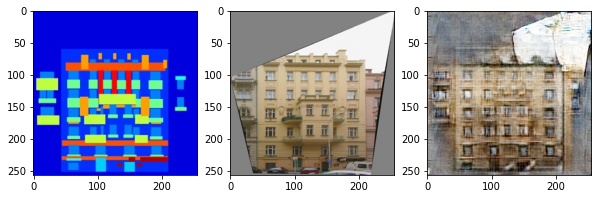

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


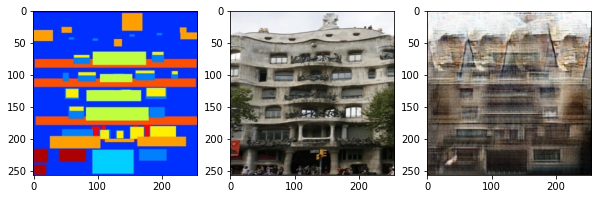

`Trainer.fit` stopped: `max_epochs=1000` reached.


In [13]:
dataset = FacadesDataset(path, target_size=target_size)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

pix2pix = Pix2Pix(3, 3, learning_rate=lr, lambda_recon=lambda_recon, display_step=display_step)
trainer = pl.Trainer(max_epochs=1000, gpus=1)
trainer.fit(pix2pix, dataloader)

In [3]:
class Upsample(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, dropout=True):
        super(Upsample, self).__init__()
        self.dropout = dropout
        self.block = nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=nn.InstanceNorm2d),
            nn.InstanceNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.dropout_layer = nn.Dropout2d(0.5)

    def forward(self, x, shortcut=None):
        x = self.block(x)
        if self.dropout:
            x = self.dropout_layer(x)

        if shortcut is not None:
            x = torch.cat([x, shortcut], dim=1)

        return x


class Downsample(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=4, stride=2, padding=1, apply_instancenorm=True):
        super(Downsample, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding, bias=nn.InstanceNorm2d)
        self.norm = nn.InstanceNorm2d(out_channels)
        self.relu = nn.LeakyReLU(0.2, inplace=True)
        self.apply_norm = apply_instancenorm

    def forward(self, x):
        x = self.conv(x)
        if self.apply_norm:
            x = self.norm(x)
        x = self.relu(x)

        return x


class CycleGAN_Unet_Generator(nn.Module):
    def __init__(self, filter=64):
        super(CycleGAN_Unet_Generator, self).__init__()
        self.downsamples = nn.ModuleList([
            Downsample(3, filter, kernel_size=4, apply_instancenorm=False),  # (b, filter, 128, 128)
            Downsample(filter, filter * 2),  # (b, filter * 2, 64, 64)
            Downsample(filter * 2, filter * 4),  # (b, filter * 4, 32, 32)
            Downsample(filter * 4, filter * 8),  # (b, filter * 8, 16, 16)
            Downsample(filter * 8, filter * 8), # (b, filter * 8, 8, 8)
            Downsample(filter * 8, filter * 8), # (b, filter * 8, 4, 4)
            Downsample(filter * 8, filter * 8), # (b, filter * 8, 2, 2)
        ])

        self.upsamples = nn.ModuleList([
            Upsample(filter * 8, filter * 8),
            Upsample(filter * 16, filter * 8),
            Upsample(filter * 16, filter * 8),
            Upsample(filter * 16, filter * 4, dropout=False),
            Upsample(filter * 8, filter * 2, dropout=False),
            Upsample(filter * 4, filter, dropout=False)
        ])

        self.last = nn.Sequential(
            nn.ConvTranspose2d(filter * 2, 3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        skips = []
        for l in self.downsamples:
            x = l(x)
            skips.append(x)

        skips = reversed(skips[:-1])
        for l, s in zip(self.upsamples, skips):
            x = l(x, s)

        out = self.last(x)

        return out


class CycleGAN_Discriminator(nn.Module):
    def __init__(self, filter=64):
        super(CycleGAN_Discriminator, self).__init__()

        self.block = nn.Sequential(
            Downsample(3, filter, kernel_size=4, stride=2, apply_instancenorm=False),
            Downsample(filter, filter * 2, kernel_size=4, stride=2),
            Downsample(filter * 2, filter * 4, kernel_size=4, stride=2),
            Downsample(filter * 4, filter * 8, kernel_size=4, stride=1),
        )

        self.last = nn.Conv2d(filter * 8, 1, kernel_size=4, stride=1, padding=1)

    def forward(self, x):
        x = self.block(x)
        x = self.last(x)

        return x

In [52]:
class CycleGAN_LightningSystem(pl.LightningModule):
    def __init__(self, G_basestyle, G_stylebase, D_base, D_style, lr, transform, reconstr_w=10, id_w=2):
        super(CycleGAN_LightningSystem, self).__init__()
        self.G_basestyle = G_basestyle
        self.G_stylebase = G_stylebase
        self.D_base = D_base
        self.D_style = D_style
        self.lr = lr
        self.transform = transform
        self.reconstr_w = reconstr_w
        self.id_w = id_w
        self.cnt_train_step = 0
        self.step = 0

        self.mae = nn.L1Loss()
        self.generator_loss = nn.MSELoss()
        self.discriminator_loss = nn.MSELoss()
        self.losses = []
        self.G_mean_losses = []
        self.D_mean_losses = []
        self.validity = []
        self.reconstr = []
        self.identity = []

    def configure_optimizers(self):
        self.g_basestyle_optimizer = torch.optim.Adam(self.G_basestyle.parameters(), lr=self.lr['G'], betas=(0.5, 0.999))
        self.g_stylebase_optimizer = torch.optim.Adam(self.G_stylebase.parameters(), lr=self.lr['G'], betas=(0.5, 0.999))
        self.d_base_optimizer = torch.optim.Adam(self.D_base.parameters(), lr=self.lr['D'], betas=(0.5, 0.999))
        self.d_style_optimizer = torch.optim.Adam(self.D_style.parameters(), lr=self.lr['D'], betas=(0.5, 0.999))

        return [self.g_basestyle_optimizer, self.g_stylebase_optimizer, self.d_base_optimizer, self.d_style_optimizer], []

    def training_step(self, batch, batch_idx, optimizer_idx):
        base_img, style_img = batch
        b = base_img.size()[0]

        valid = torch.ones(b, 1, 30, 30).cuda()
        fake = torch.zeros(b, 1, 30, 30).cuda()

        # Train Generator
        if optimizer_idx == 0 or optimizer_idx == 1:
            # Validity
            # MSELoss
            val_base = self.generator_loss(self.D_base(self.G_stylebase(style_img)), valid)
            val_style = self.generator_loss(self.D_style(self.G_basestyle(base_img)), valid)
            val_loss = (val_base + val_style) / 2

            # Reconstruction
            reconstr_base = self.mae(self.G_stylebase(self.G_basestyle(base_img)), base_img)
            reconstr_style = self.mae(self.G_basestyle(self.G_stylebase(style_img)), style_img)
            reconstr_loss = (reconstr_base + reconstr_style) / 2

            # Identity
            id_base = self.mae(self.G_stylebase(base_img), base_img)
            id_style = self.mae(self.G_basestyle(style_img), style_img)
            id_loss = (id_base + id_style) / 2

            # Loss Weight
            G_loss = val_loss + self.reconstr_w * reconstr_loss + self.id_w * id_loss

            return {'loss': G_loss, 'validity': val_loss, 'reconstr': reconstr_loss, 'identity': id_loss}

        # Train Discriminator
        elif optimizer_idx == 2 or optimizer_idx == 3:
            # MSELoss
            D_base_gen_loss = self.discriminator_loss(self.D_base(self.G_stylebase(style_img)), fake)
            D_style_gen_loss = self.discriminator_loss(self.D_style(self.G_basestyle(base_img)), fake)
            D_base_valid_loss = self.discriminator_loss(self.D_base(base_img), valid)
            D_style_valid_loss = self.discriminator_loss(self.D_style(style_img), valid)
            
            D_gen_loss = (D_base_gen_loss + D_style_gen_loss) / 2
            
            # Loss Weight
            D_loss = (D_gen_loss + D_base_valid_loss + D_style_valid_loss) / 3

            # Count up
            self.cnt_train_step += 1

            return {'loss': D_loss}

    def training_epoch_end(self, outputs):
        self.step += 1
        
        avg_loss = sum([torch.stack([x['loss'] for x in outputs[i]]).mean().item() / 4 for i in range(4)])
        G_mean_loss = sum([torch.stack([x['loss'] for x in outputs[i]]).mean().item() / 2 for i in [0, 1]])
        D_mean_loss = sum([torch.stack([x['loss'] for x in outputs[i]]).mean().item() / 2 for i in [2, 3]])
        validity = sum([torch.stack([x['validity'] for x in outputs[i]]).mean().item() / 2 for i in [0, 1]])
        reconstr = sum([torch.stack([x['reconstr'] for x in outputs[i]]).mean().item() / 2 for i in [0, 1]])
        identity = sum([torch.stack([x['identity'] for x in outputs[i]]).mean().item() / 2 for i in [0, 1]])
            
        self.losses.append(avg_loss)
        self.G_mean_losses.append(G_mean_loss)
        self.D_mean_losses.append(D_mean_loss)
        self.validity.append(validity)
        self.reconstr.append(reconstr)
        self.identity.append(identity)
        
        if self.step % 10 == 0:
            # Display Model Output
            transform = transforms.ToPILImage()
            target_imgs = [self.transform(transform(dataset[i][0]), phase='test') for i in range(4)]
            target_imgs = torch.stack(target_imgs, dim=0)
            target_imgs = target_imgs.cuda()

            gen_imgs = self.G_basestyle(target_imgs)
            gen_img = torch.cat([target_imgs, gen_imgs], dim=0)

            # Reverse Normalization
            gen_img = gen_img * 0.5 + 0.5
            gen_img = gen_img * 255

            joined_images_tensor = make_grid(gen_img, nrow=4, padding=2)

            joined_images = joined_images_tensor.detach().cpu().numpy().astype(int)
            joined_images = np.transpose(joined_images, [1,2,0])

            # Visualize
            fig = plt.figure(figsize=(18, 8))
            plt.imshow(joined_images)
            plt.axis('off')
            plt.title(f'Epoch {self.step}')
            plt.show()
            plt.clf()
            plt.close()
            
            target_imgs = [self.transform(transform(dataset[i][1]), phase='test') for i in range(4)]
            target_imgs = torch.stack(target_imgs, dim=0)
            target_imgs = target_imgs.cuda()

            gen_imgs = self.G_stylebase(target_imgs)
            gen_img = torch.cat([target_imgs, gen_imgs], dim=0)

            # Reverse Normalization
            gen_img = gen_img * 0.5 + 0.5
            gen_img = gen_img * 255

            joined_images_tensor = make_grid(gen_img, nrow=4, padding=2)

            joined_images = joined_images_tensor.detach().cpu().numpy().astype(int)
            joined_images = np.transpose(joined_images, [1,2,0])

            # Visualize
            fig = plt.figure(figsize=(18, 8))
            plt.imshow(joined_images)
            plt.axis('off')
            plt.title(f'Epoch {self.step}')
            plt.show()
            plt.clf()
            plt.close()

        return None

In [53]:
def init_weights(net, init_type='normal', init_gain=0.02):
    """Initialize network weights.
    Parameters:
        net (network)   -- network to be initialized
        init_type (str) -- the name of an initialization method: normal | xavier | kaiming | orthogonal
        init_gain (float)    -- scaling factor for normal, xavier and orthogonal.
    We use 'normal' in the original pix2pix and CycleGAN paper. But xavier and kaiming might
    work better for some applications. Feel free to try yourself.
    """
    def init_func(m):  # define the initialization function
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
            if init_type == 'normal':
                nn.init.normal_(m.weight.data, 0.0, init_gain)
            elif init_type == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=init_gain)
            elif init_type == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            elif init_type == 'orthogonal':
                nn.init.orthogonal_(m.weight.data, gain=init_gain)
            else:
                raise NotImplementedError('initialization method [%s] is not implemented' % init_type)
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
            nn.init.normal_(m.weight.data, 1.0, init_gain)
            nn.init.constant_(m.bias.data, 0.0)

    net.apply(init_func)  # apply the initialization function <init_func>

In [54]:
class ImageTransform:
    def __init__(self, img_size=256):
        self.transform = {
            'train': transforms.Compose([
                transforms.Resize((img_size, img_size)),
                transforms.RandomHorizontalFlip(),
                transforms.RandomVerticalFlip(),
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.5], std=[0.5])
            ]),
            'test': transforms.Compose([
                transforms.Resize((img_size, img_size)),
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.5], std=[0.5])
            ])}

    def __call__(self, img, phase='train'):
        img = self.transform[phase](img)

        return img

GPU available: True, used: True
TPU available: None, using: 0 TPU cores

  | Name               | Type                    | Params
---------------------------------------------------------------
0 | G_basestyle        | CycleGAN_Unet_Generator | 41.8 M
1 | G_stylebase        | CycleGAN_Unet_Generator | 41.8 M
2 | D_base             | CycleGAN_Discriminator  | 2.8 M 
3 | D_style            | CycleGAN_Discriminator  | 2.8 M 
4 | mae                | L1Loss                  | 0     
5 | generator_loss     | MSELoss                 | 0     
6 | discriminator_loss | MSELoss                 | 0     
---------------------------------------------------------------
89.2 M    Trainable params
0         Non-trainable params
89.2 M    Total params
356.723   Total estimated model params size (MB)


Training: 0it [00:00, ?it/s]

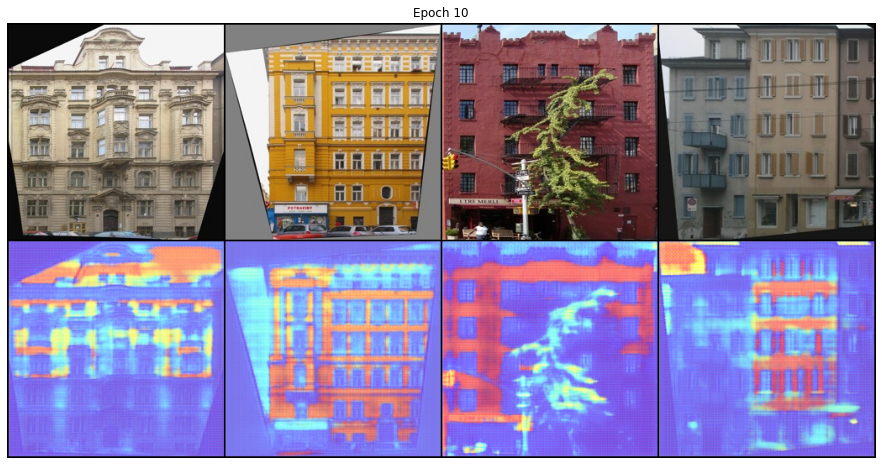

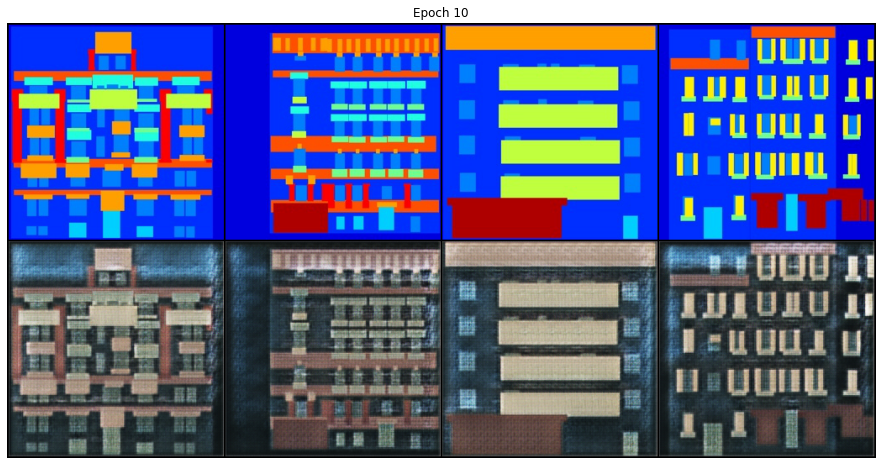

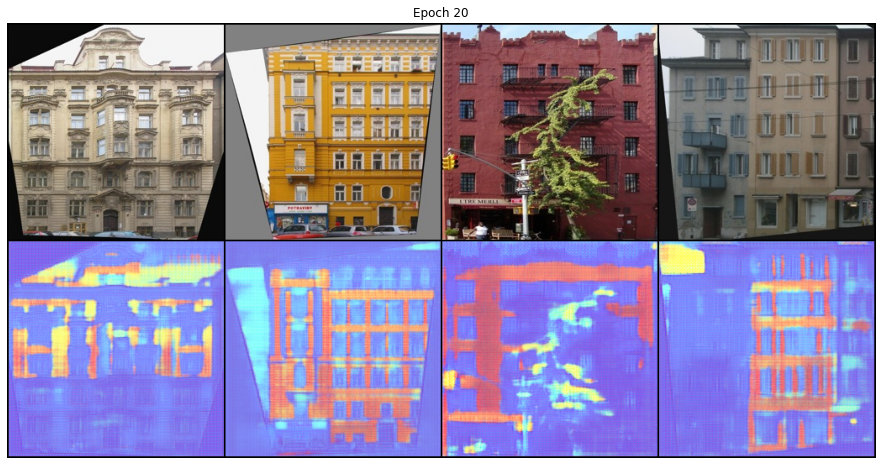

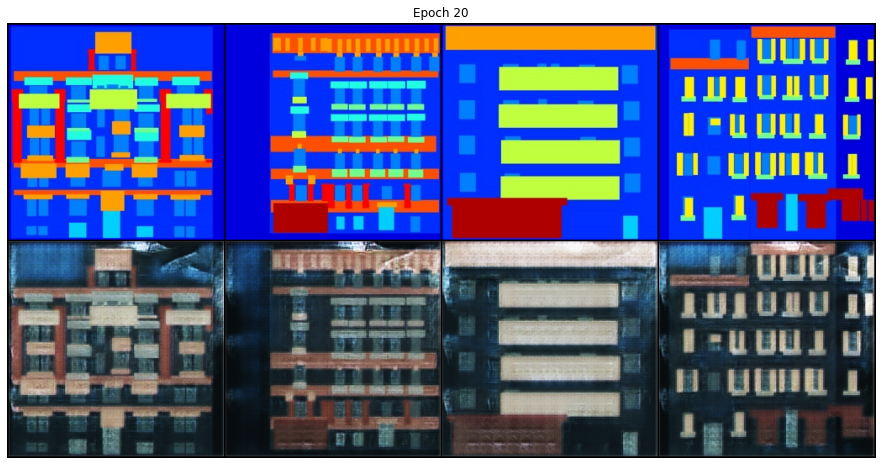

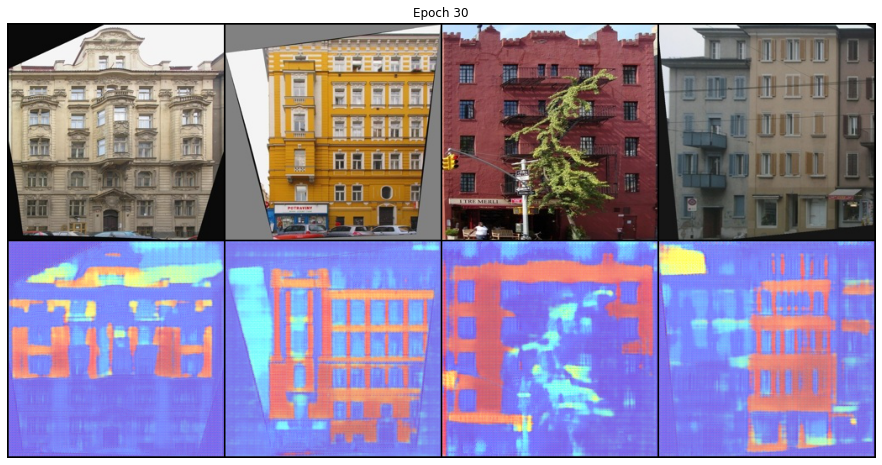

...

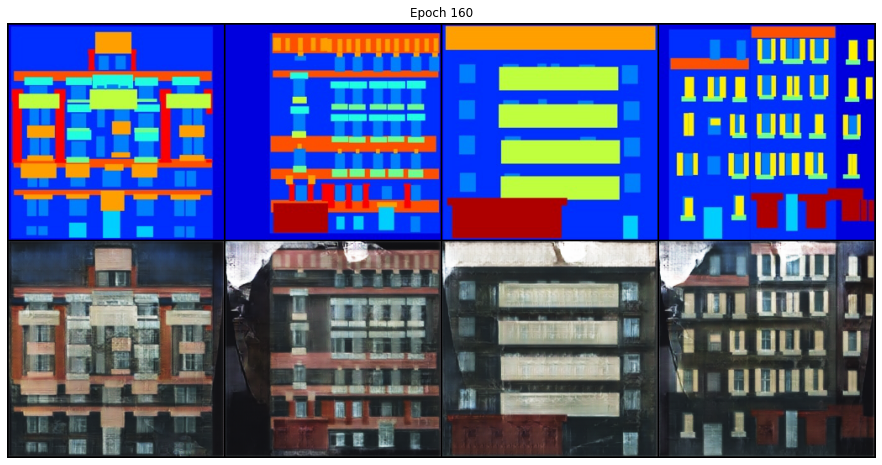

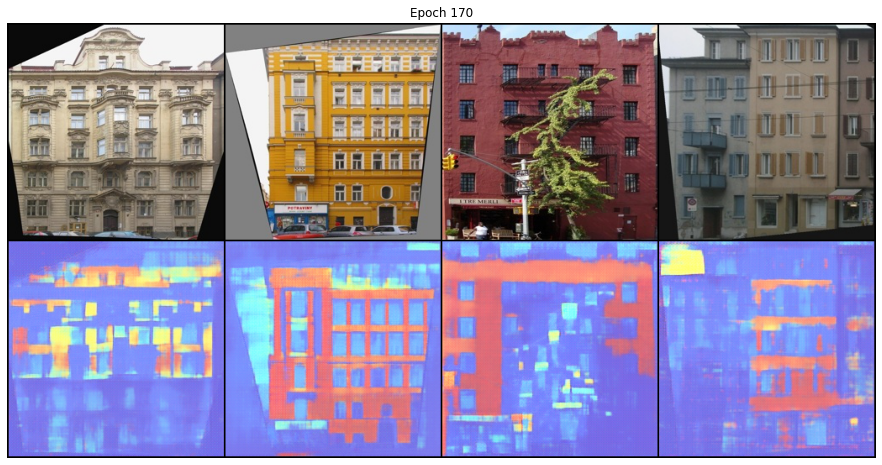

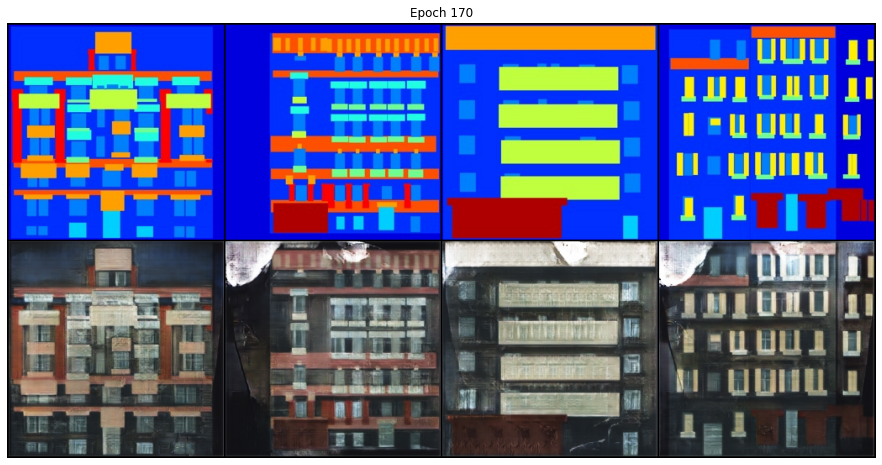

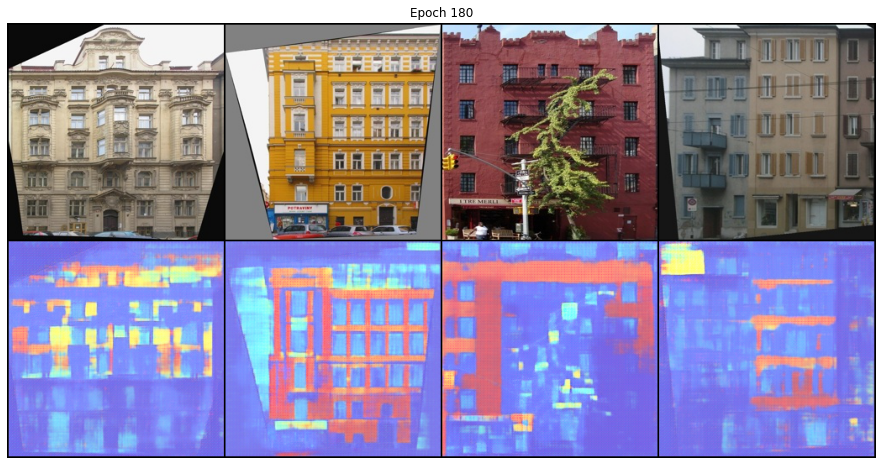

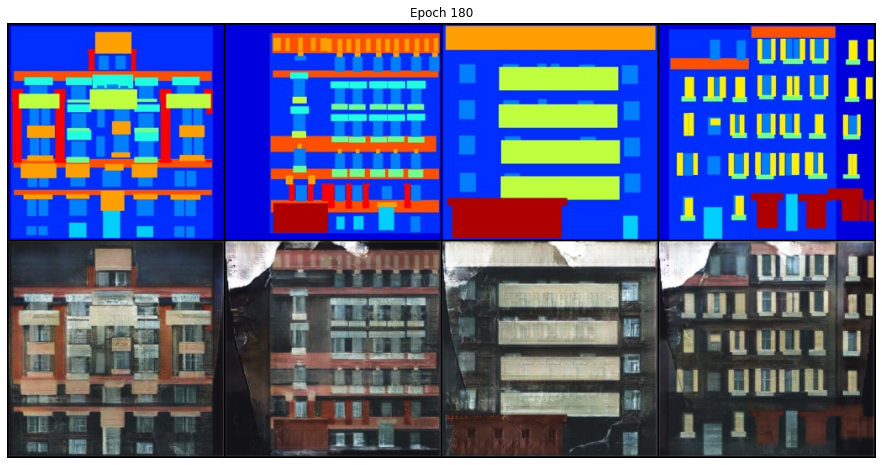

1

In [55]:
target_size = 256
transform = ImageTransform(img_size=256)
batch_size = 1
lr = {
    'G': 0.0002,
    'D': 0.0002
}
epoch = 180
seed = 42
reconstr_w = 10
id_w = 2

G_basestyle = CycleGAN_Unet_Generator()
G_stylebase = CycleGAN_Unet_Generator()
D_base = CycleGAN_Discriminator()
D_style = CycleGAN_Discriminator()

# Init Weight  --------------------------------------------------------------
for net in [G_basestyle, G_stylebase, D_base, D_style]:
    init_weights(net, init_type='normal')

# LightningModule  --------------------------------------------------------------
model = CycleGAN_LightningSystem(G_basestyle, G_stylebase, D_base, D_style, 
                                 lr, transform, reconstr_w, id_w)

# Trainer  --------------------------------------------------------------
trainer = pl.Trainer(
    logger=False,
    max_epochs=epoch,
    gpus=1,
    checkpoint_callback=False,
    reload_dataloaders_every_epoch=True,
    num_sanity_val_steps=0,
)


# Train
dataset = FacadesDataset(path, target_size=target_size)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
trainer.fit(model, dataloader)